In [4]:
# importation des bibliothéques
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import os
import seaborn as sns
import numpy as np 
from skimage.util import montage
from skimage.segmentation import mark_boundaries
import tensorflow as tf

In [5]:
train_image_dir = "/kaggle/input/airbus-ship-detection/train_v2"
train_encode_file = "/kaggle/input/airbus-ship-detection/train_ship_segmentations_v2.csv"
test_image_dir= "/kaggle/input/airbus-ship-detection/test_v2"

In [6]:
#Le répertoire du train
train_images = os.listdir(train_image_dir)
print(f"Total  {len(train_images)} images dans le répertoire du train . \nvoici les 5 premières images  : - {train_images[:5]}   ")

Total  192556 images dans le répertoire du train . 
voici les 5 premières images  : - ['d8bc90fd6.jpg', 'ee783cf9f.jpg', '4b0d96146.jpg', '7c8d78c3f.jpg', '290f37d66.jpg']   


In [7]:
#Le répertoire du test
test_images = os.listdir(test_image_dir)
print(f"Total  {len(test_images)} images dans le répertoire du test . \nvoici les 5 premières images  : - {test_images[:5]}   ")

Total  15606 images dans le répertoire du test . 
voici les 5 premières images  : - ['4291f3a66.jpg', 'b0808caaf.jpg', '9f582d5ce.jpg', '916ae8dd3.jpg', '6fa533973.jpg']   


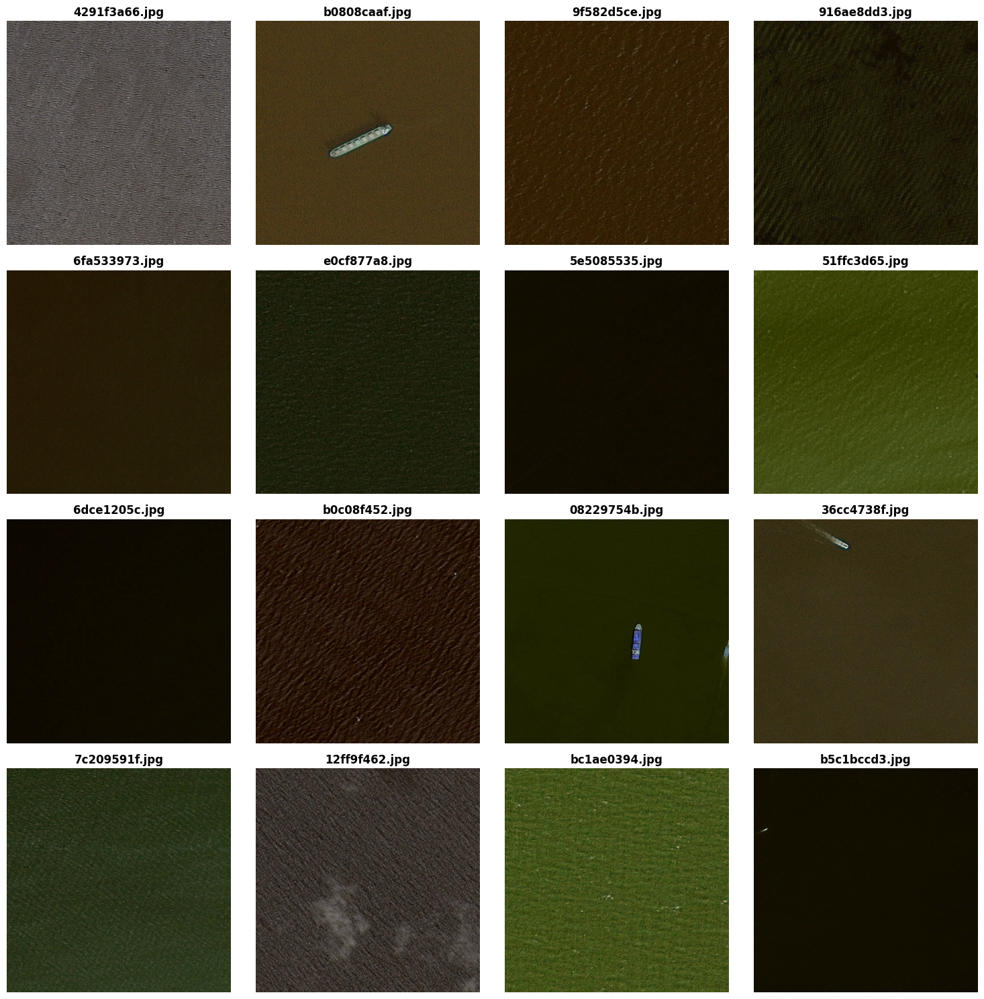

In [8]:
# visualiser quelques images de tests
plt.figure(figsize=(15,15))
for i in range(16):
    plt.subplot(4,4,i+1)
    plt.imshow(cv2.imread(test_image_dir+ '/' +test_images[i]))
    plt.title(f"{test_images[i]}", weight='bold')
    plt.axis('off')
plt.tight_layout()

In [9]:
df = pd.read_csv(train_encode_file)

In [10]:
df.info() #qlq infomrations sur train_encode_file

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 231723 entries, 0 to 231722
Data columns (total 2 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   ImageId        231723 non-null  object
 1   EncodedPixels  81723 non-null   object
dtypes: object(2)
memory usage: 3.5+ MB


In [11]:
df.describe()

,ImageId,EncodedPixels
count,231723,81723
unique,192556,81722
top,ad5092ca2.jpg,43801 1 44567 4 45334 5 46100 8 46867 9 47636 ...
freq,15,2


In [12]:
df.head(10)

,ImageId,EncodedPixels
0,00003e153.jpg,NaN
1,0001124c7.jpg,NaN
2,000155de5.jpg,264661 17 265429 33 266197 33 266965 33 267733...
3,000194a2d.jpg,360486 1 361252 4 362019 5 362785 8 363552 10 ...
4,000194a2d.jpg,51834 9 52602 9 53370 9 54138 9 54906 9 55674 ...
5,000194a2d.jpg,198320 10 199088 10 199856 10 200624 10 201392...
6,000194a2d.jpg,55683 1 56451 1 57219 1 57987 1 58755 1 59523 ...
7,000194a2d.jpg,254389 9 255157 17 255925 17 256693 17 257461 ...
8,0001b1832.jpg,NaN
9,00021ddc3.jpg,108287 1 109054 3 109821 4 110588 5 111356 5 1...


In [13]:
df[df["ImageId"]=="00021ddc3.jpg"] # dans df, dans la même image nous avons plus d'un navire et chaque navire est rangée dans une ligne de notre table df

,ImageId,EncodedPixels
9,00021ddc3.jpg,108287 1 109054 3 109821 4 110588 5 111356 5 1...
10,00021ddc3.jpg,101361 1 102128 3 102896 4 103663 6 104430 9 1...
11,00021ddc3.jpg,74441 3 75207 5 75975 5 76743 5 77511 5 78280 ...
12,00021ddc3.jpg,74444 4 75212 4 75980 4 76748 4 77517 3 78285 ...
13,00021ddc3.jpg,150423 2 151190 3 151958 3 152726 4 153495 3 1...
14,00021ddc3.jpg,139644 2 140408 6 141174 9 141942 9 142711 6 1...
15,00021ddc3.jpg,75972 3 76738 5 77506 5 78274 5 79042 6 79811 ...
16,00021ddc3.jpg,86727 2 87493 4 88261 4 89030 3 89798 4 90566 ...
17,00021ddc3.jpg,95225 2 95992 5 96760 7 97527 9 98294 9 99062 ...


In [14]:
# construire un dictionnaire dont la clé est l'id de l'image et la valeur est le nombre des navires présents dans l'image
ship_num = {}

for index, ligne in df.iterrows():
    id_image = ligne['ImageId']
    encoding = ligne['EncodedPixels']
    
    if pd.isna(encoding) or encoding == "":
        ship_num[id_image] = 0
    else:
        if id_image in ship_num:
            ship_num[id_image] += 1
        else:
            ship_num[id_image] = 1

print(ship_num)

{'00003e153.jpg': 0, '0001124c7.jpg': 0, '000155de5.jpg': 1, '000194a2d.jpg': 5, '0001b1832.jpg': 0, '00021ddc3.jpg': 9, '0002756f7.jpg': 2, '0002d0f32.jpg': 0, '000303d4d.jpg': 0, '00031f145.jpg': 1, '00052ed46.jpg': 0, '000532683.jpg': 2, '00053c6ba.jpg': 1, '00057a50d.jpg': 0, '000592296.jpg': 0, '0005d01c8.jpg': 2, '0005d6d95.jpg': 1, '0006c52e8.jpg': 1, '0007b8229.jpg': 0, '000805313.jpg': 0, '000811bb6.jpg': 0, '0008d6216.jpg': 0, '000913daf.jpg': 0, '000952d51.jpg': 0, '000969125.jpg': 0, '0009a46e1.jpg': 0, '000a4d4fd.jpg': 0, '000aed819.jpg': 0, '000baef0c.jpg': 0, '000bd9ac4.jpg': 0, '000c150b0.jpg': 0, '000c34352.jpg': 0, '000d26c17.jpg': 0, '000d42241.jpg': 1, '000db3e62.jpg': 0, '000e37fc6.jpg': 0, '000e6378b.jpg': 1, '000e64855.jpg': 0, '000f1f959.jpg': 0, '000f7e728.jpg': 0, '000f7f2fd.jpg': 0, '000fd9827.jpg': 1, '00104f16f.jpg': 0, '0010e88ce.jpg': 0, '0010eefb1.jpg': 0, '00113a75c.jpg': 7, '00119e4ba.jpg': 0, '0011a9ccb.jpg': 0, '0011c31b7.jpg': 0, '00122061c.jpg': 0,

nombres de navires dans cette image est : 1


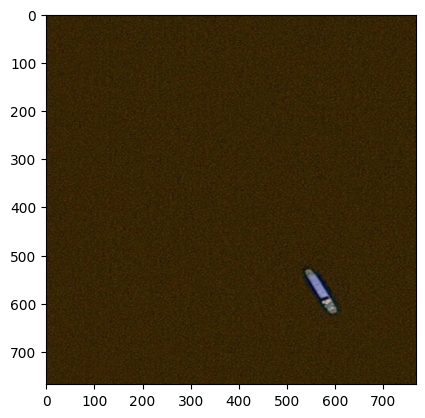

In [15]:
img=cv2.imread(train_image_dir+"/30d3f7721.jpg")
plt.imshow(img)
print(f"nombres de navires dans cette image est : {ship_num['30d3f7721.jpg'] }") #on verifie le nombre de navire pour l'image d'id 30d3f7721.jpg

In [16]:
print(len(ship_num))
#coinside avec le nombre unique des element 
# nombre des images

192556


In [17]:
# Transformez le dictionnaire en DataFrame pour faciliter la manipulation des informations
MonData = pd.DataFrame(list(ship_num.items()), columns=['ImageId', 'ships'])

In [18]:
MonData.head(10)

,ImageId,ships
0,00003e153.jpg,0
1,0001124c7.jpg,0
2,000155de5.jpg,1
3,000194a2d.jpg,5
4,0001b1832.jpg,0
5,00021ddc3.jpg,9
6,0002756f7.jpg,2
7,0002d0f32.jpg,0
8,000303d4d.jpg,0
9,00031f145.jpg,1


cette image d'id "00003e153.jpg" ne represente aucune navire d'aprés le tableau précédent.


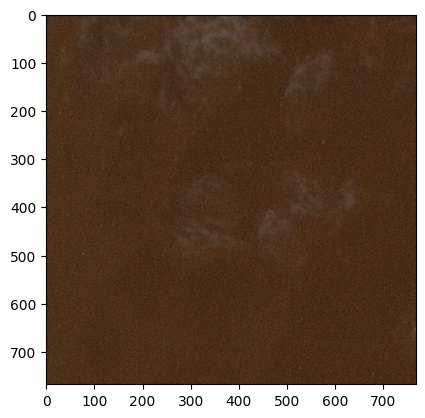

In [19]:
#on a verifier que l'image dont l'id est 00003e153.jpg ne presente pas des navires
img=cv2.imread(train_image_dir +"/00003e153.jpg")
plt.imshow(img)
print("cette image d'id \"00003e153.jpg\" ne represente aucune navire d'aprés le tableau précédent.")

/tmp/ipykernel_13/1165834849.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=MonData, x ='ships', palette='Set2')


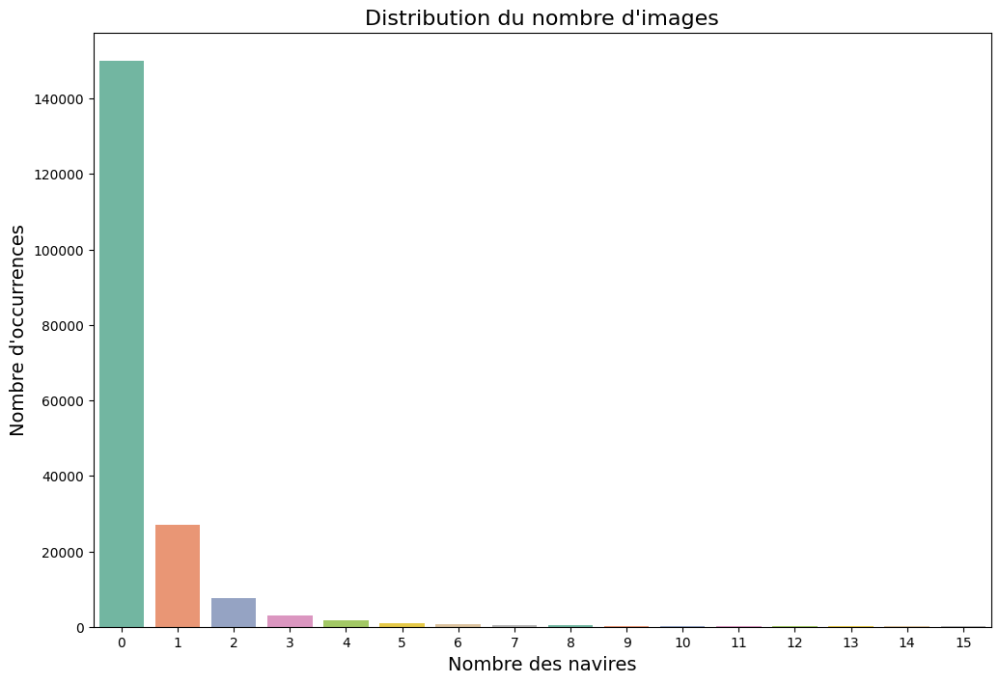

In [20]:
plt.figure(figsize=(12, 8)) # Ajuster la taille de la figure
sns.countplot(data=MonData, x ='ships', palette='Set2')
# Ajouter des labels et un titre
plt.title('Distribution du nombre d\'images', fontsize=16)
plt.xlabel('Nombre des navires', fontsize=14)
plt.ylabel('Nombre d\'occurrences', fontsize=14)
plt.show()

In [21]:
MonData['ships'].value_counts() # nombre des image qui ont le meme nombre des navires
#On peut observer un déséquilibre dans la répartition des images en fonction du nombre de navires.

ships
0     150000
1      27104
2       7674
3       2954
4       1622
5        925
6        657
7        406
8        318
9        243
10       168
11       144
12       124
14        76
13        75
15        66
Name: count, dtype: int64

In [22]:
# list of image paths
image_paths = [
    os.path.join(train_image_dir, filename) for filename in os.listdir(train_image_dir)
]

In [23]:
image_paths[10:20]

['/kaggle/input/airbus-ship-detection/train_v2/30d3f7721.jpg',
 '/kaggle/input/airbus-ship-detection/train_v2/a1137f4a7.jpg',
 '/kaggle/input/airbus-ship-detection/train_v2/0cd27e395.jpg',
 '/kaggle/input/airbus-ship-detection/train_v2/08c5215b6.jpg',
 '/kaggle/input/airbus-ship-detection/train_v2/1f6c6ee44.jpg',
 '/kaggle/input/airbus-ship-detection/train_v2/43d5e047d.jpg',
 '/kaggle/input/airbus-ship-detection/train_v2/75cac0232.jpg',
 '/kaggle/input/airbus-ship-detection/train_v2/b23c16f4e.jpg',
 '/kaggle/input/airbus-ship-detection/train_v2/3ff2c6cd5.jpg',
 '/kaggle/input/airbus-ship-detection/train_v2/208de942c.jpg']

In [24]:
print(df.isnull().sum()) # Vérifier s'il y a des valeurs manquantes

ImageId               0
EncodedPixels    150000
dtype: int64


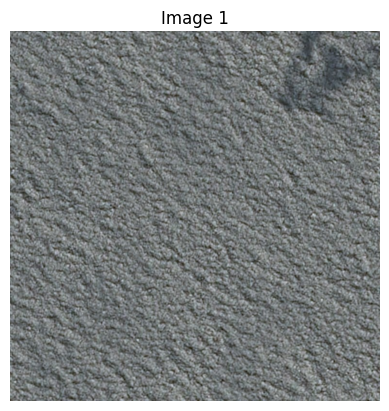

Dimensions de l'image : 768 x 768 pixels
Nombre de canaux : 3
Taille de l'image : 589824 pixels


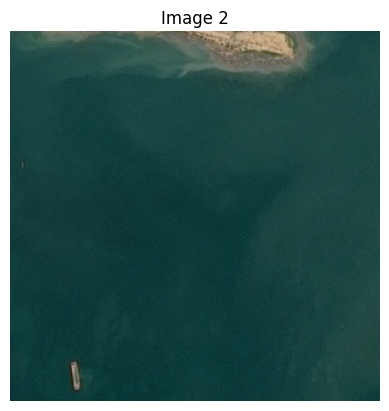

Dimensions de l'image : 768 x 768 pixels
Nombre de canaux : 3
Taille de l'image : 589824 pixels


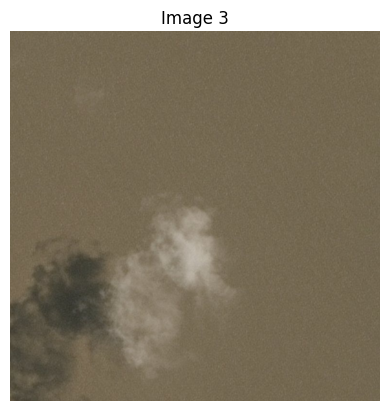

Dimensions de l'image : 768 x 768 pixels
Nombre de canaux : 3
Taille de l'image : 589824 pixels


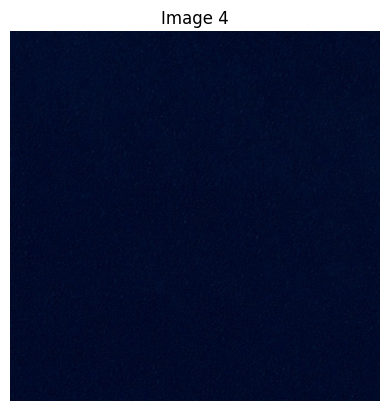

Dimensions de l'image : 768 x 768 pixels
Nombre de canaux : 3
Taille de l'image : 589824 pixels


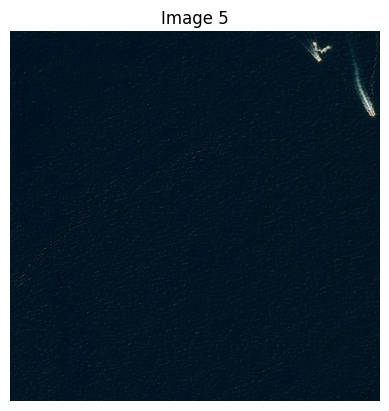

Dimensions de l'image : 768 x 768 pixels
Nombre de canaux : 3
Taille de l'image : 589824 pixels


In [25]:
# Analyse détaillée des images
for i in range(5):
    image = cv2.imread(image_paths[i])
    hauteur, largeur, canaux = image.shape  # Obtenir les dimensions de l'image
    taille_image = hauteur * largeur       # Calculer la taille de l'image
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(f"Image {i + 1}")
    plt.axis('off')
    plt.show()
    print(f"Dimensions de l'image : {hauteur} x {largeur} pixels")
    print(f"Nombre de canaux : {canaux}")
    print(f"Taille de l'image : {taille_image} pixels")

In [26]:
print('nombre des images dans csv ',len(df))
print('nombre des images dans fichier image ',len(image_paths))

nombre des images dans csv  231723
nombre des images dans fichier image  192556


le nombre des images sans navire 150000
le nombre des images avec navire 42556


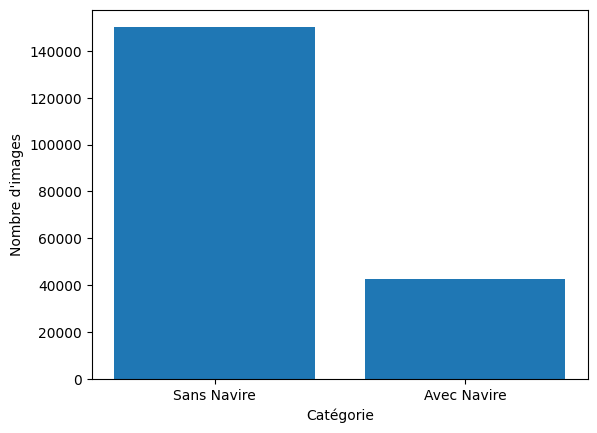

In [27]:
nombre_images_sans_navire = 0
nombre_images_avec_navire = 0

# Parcourez le dictionnaire ship_num
for nombre_navires in ship_num.values():
    if nombre_navires == 0:
        nombre_images_sans_navire += 1
    else:
        nombre_images_avec_navire += 1

# Créez deux listes pour les abscisses et les ordonnées du graphique
categories = ['Sans Navire', 'Avec Navire']
nombre_images = [nombre_images_sans_navire, nombre_images_avec_navire]
print("le nombre des images sans navire",nombre_images_sans_navire)
print("le nombre des images avec navire",nombre_images_avec_navire)
# Créez un graphique à barres
plt.bar(categories, nombre_images)

# Étiquetez les axes du graphique
plt.xlabel('Catégorie')
plt.ylabel('Nombre d\'images')

# Affichez le graphique
plt.show()

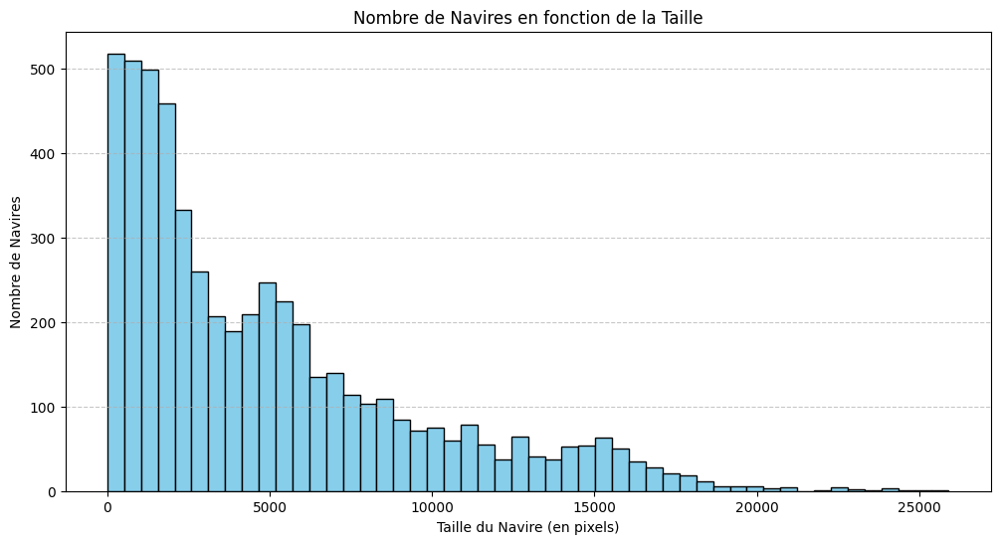

In [28]:
# Créer une nouvelle colonne 'Size' qui contient le nombre de pixels par navire
df['Size'] = df['EncodedPixels'].apply(lambda x: 0 if pd.isna(x) else sum(map(int, str(x).split()[1::2])))

# Grouper les données par taille et compter le nombre de navires de chaque taille
tailles_navires = df[df['Size'] > 0]['Size'].value_counts().reset_index()
tailles_navires.columns = ['Taille du Navire (en pixels)', 'Nombre de Navires']

# Trier les données par taille croissante
tailles_navires = tailles_navires.sort_values(by='Taille du Navire (en pixels)')

# Tracer le graphique
plt.figure(figsize=(12, 6))
plt.hist(tailles_navires['Taille du Navire (en pixels)'], bins=50, color='skyblue', edgecolor='black')
#plt.bar(tailles_navires['Taille du Navire (en pixels)'], tailles_navires['Nombre de Navires'])
plt.title('Nombre de Navires en fonction de la Taille')
plt.xlabel('Taille du Navire (en pixels)')
plt.ylabel('Nombre de Navires')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

In [29]:
df['file_size_kb']=df['ImageId'].map(lambda c_img_id:os.stat(os.path.join(train_image_dir,c_img_id)).st_size/1024) # calcul de taille des fichiers


In [30]:
df.head()

,ImageId,EncodedPixels,Size,file_size_kb
0,00003e153.jpg,NaN,0,128.944336
1,0001124c7.jpg,NaN,0,76.059570
2,000155de5.jpg,264661 17 265429 33 266197 33 266965 33 267733...,3388,147.625977
3,000194a2d.jpg,360486 1 361252 4 362019 5 362785 8 363552 10 ...,177,75.221680
4,000194a2d.jpg,51834 9 52602 9 53370 9 54138 9 54906 9 55674 ...,148,75.221680


In [31]:
def plot_color_histogram(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # Convertir l'image de BGR à RGB (Matplotlib utilise le format RGB)
    plt.imshow(image_rgb)
    plt.title('Image originale')
    plt.axis('off')
    plt.show()
    r, g, b = cv2.split(image_rgb)  # Diviser l'image en ses canaux de couleur (Rouge, Vert, Bleu)
    plt.figure(figsize=(12, 4))
    # Histogramme pour le canal rouge
    plt.subplot(131)
    plt.hist(r.flatten(), bins=256, color='red', alpha=0.7, rwidth=0.8)
    plt.title('Histogramme Rouge')
    plt.xlabel('Valeur de pixel')
    plt.ylabel('Fréquence')

    # Histogramme pour le canal vert
    plt.subplot(132)
    plt.hist(g.flatten(), bins=256, color='green', alpha=0.7, rwidth=0.8)
    plt.title('Histogramme Vert')
    plt.xlabel('Valeur de pixel')
    plt.ylabel('Fréquence')

    # Histogramme pour le canal bleu
    plt.subplot(133)
    plt.hist(b.flatten(), bins=256, color='blue', alpha=0.7, rwidth=0.8)
    plt.title('Histogramme Bleu')
    plt.xlabel('Valeur de pixel')
    plt.ylabel('Fréquence')
    plt.tight_layout()
    plt.show()

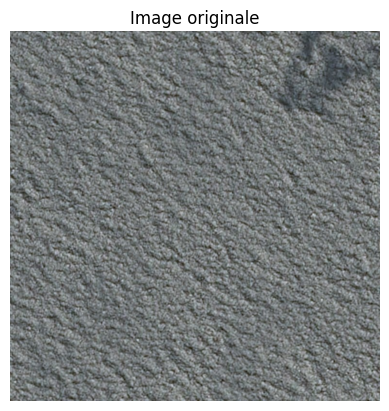

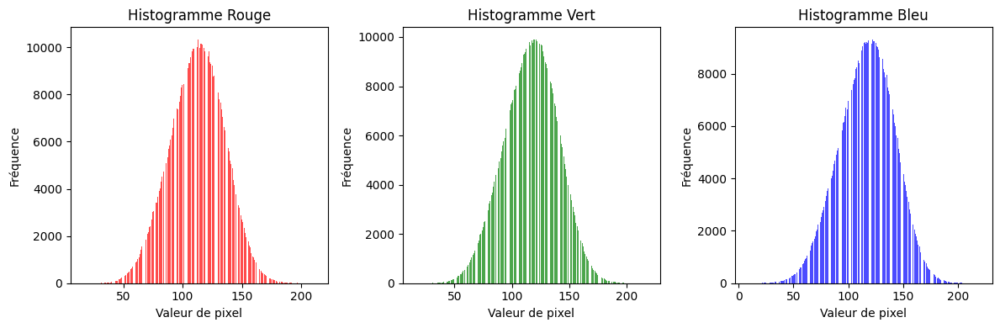

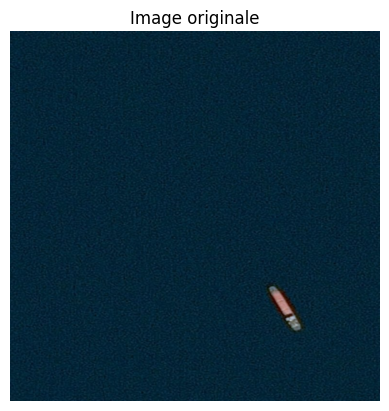

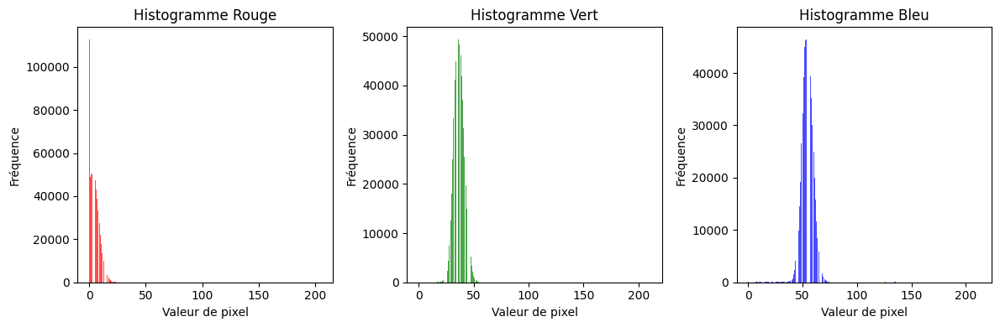

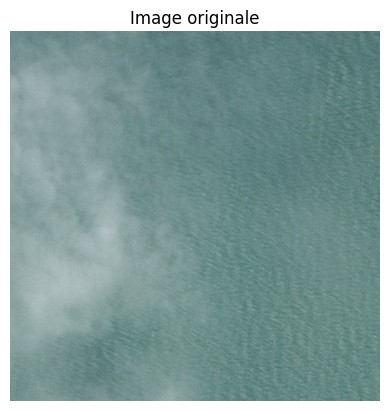

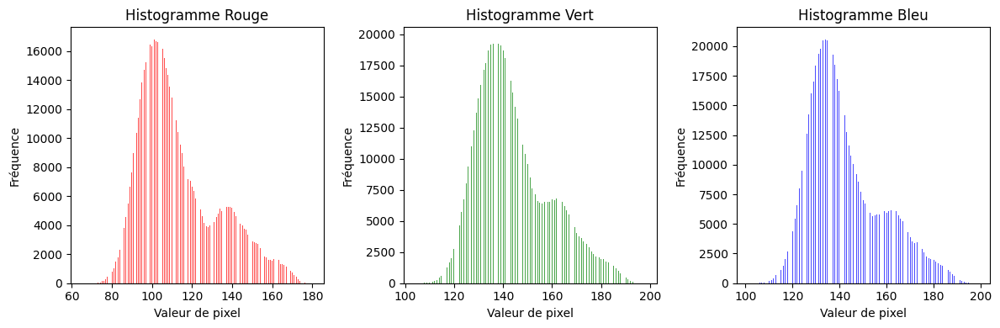

In [32]:
plot_color_histogram(image_paths[0])
plot_color_histogram(image_paths[10])
plot_color_histogram(image_paths[900])

In [33]:
def orientation_distribution(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)  # Charger l'image en niveaux de gris
    # Appliquer le filtre de Sobel pour obtenir les gradients
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=5)
    
    gradient_orientation = np.arctan2(sobely, sobelx) # Calculer l'orientation des gradients
    gradient_orientation_degrees = np.degrees(gradient_orientation) # Convertir l'orientation en degrés
    flattened_orientation = gradient_orientation_degrees.flatten()  # Aplatir l'array pour l'histogramme
    # Afficher l'image originale
    plt.subplot(121)
    plt.imshow(image, cmap='gray')
    plt.title('Image originale')
    plt.axis('off')
    # Afficher l'histogramme des orientations
    plt.subplot(122)
    plt.hist(flattened_orientation, bins=36, range=[-180, 180], color='black', alpha=0.7)
    plt.title('Histogramme des orientations')
    plt.xlabel('Orientation en degrés')
    plt.ylabel('Fréquence')
    plt.tight_layout()  # Ajuster automatiquement les espaces pour éviter le chevauchement
    plt.show()

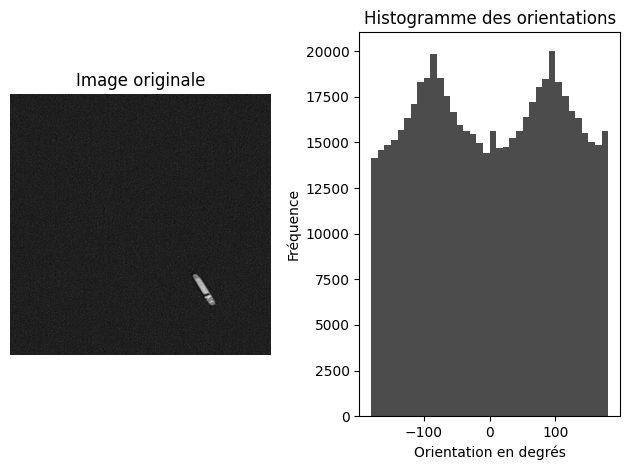

In [34]:
orientation_distribution(image_paths[10])

**la fréquence maximale du diagramme est de 17500, ce qui correspond à une orientation de 100 degrés. Cela suggère que l'orientation dominante des objets dans l'image est de 100 degrés, qui correspond a l'orientation du navire**

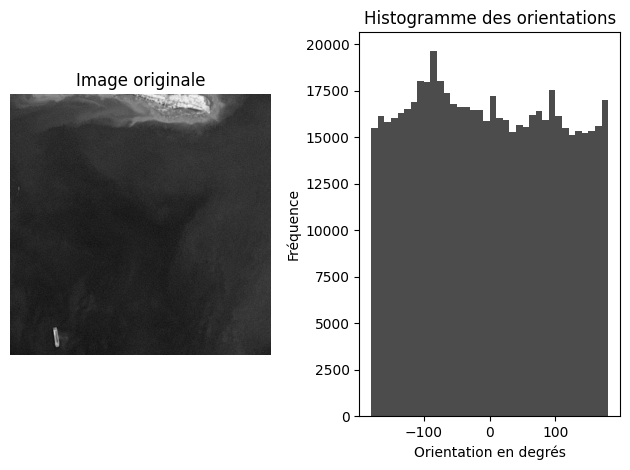

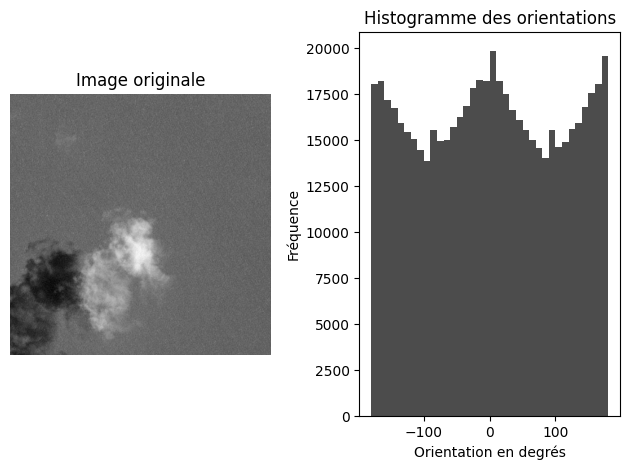

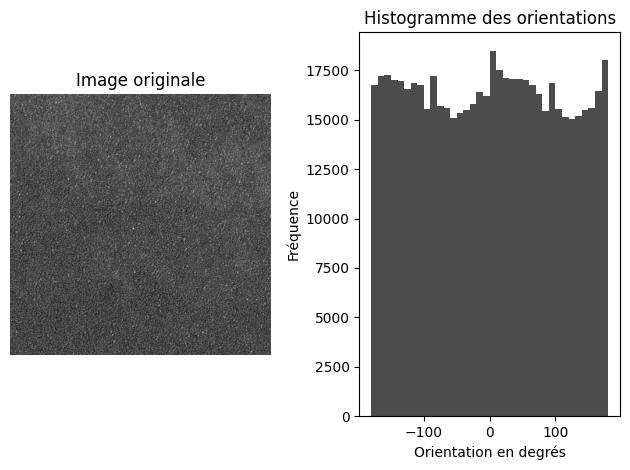

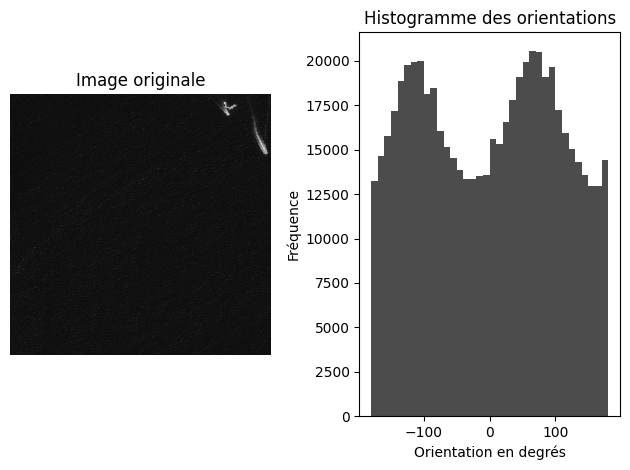

In [35]:
for i in range (1,5):
    orientation_distribution(image_paths[i])

In [36]:
def detect_keypoints(image_path):
    image = cv2.imread(image_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    orb = cv2.ORB_create() # Initialiser l'extracteur ORB
    keypoints, descriptors = orb.detectAndCompute(gray_image, None)  # Détecter les points d'intérêt et les descripteurs avec ORB
    image_with_keypoints = cv2.drawKeypoints(image, keypoints, None) # Dessiner les points d'intérêt sur l'image
    # Afficher l'image avec les points d'intérêt
    plt.imshow(cv2.cvtColor(image_with_keypoints, cv2.COLOR_BGR2RGB))
    plt.title('Détection de points d\'intérêt avec ORB (Oriented FAST and Rotated BRIEF)')
    plt.axis('off')
    plt.show()

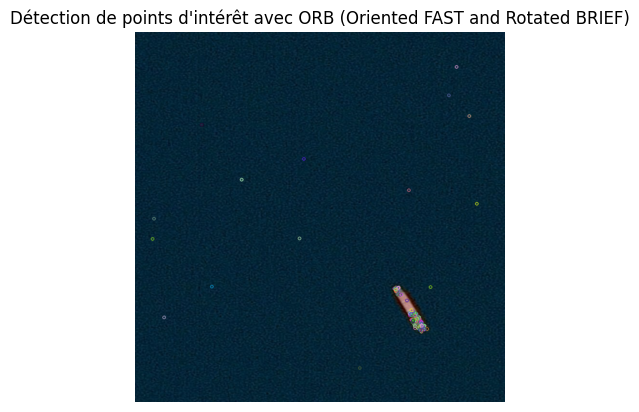

In [37]:
detect_keypoints(image_paths[10])

**on remarque que la plupart des points d'intérêt obtenus par le filtre ORB est sur le navire**

In [38]:
def evaluate_sharpness_contrast(image_path):
    image = cv2.imread(image_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    laplacian = cv2.Laplacian(gray_image, cv2.CV_64F) # Calculer le filtre Laplacien pour évaluer la netteté
    sharpness = np.var(laplacian) # Calculer la variance de l'image Laplacienne pour la netteté
    contrast = np.max(gray_image) - np.min(gray_image) # Calculer le contraste de l'image
    # Normaliser les valeurs entre 0 et 1
    sharpness_normalized = sharpness / (sharpness + contrast)
    contrast_normalized = contrast / (sharpness + contrast)
    # Produire un score global normalisé
    score_normalized = (sharpness_normalized + contrast_normalized) / 2
    return score_normalized

**on a 192 225 exemples, analyser toutes les images serait trop coûteux en temps d'exécution. Nous nous concentrons donc sur un échantillon de 4000 images pour maintenir l'efficacité de la fonction evaluate_sharpness_contrast et le bloc de code qui calcule le shape**

In [39]:
contrast= set() # initialisation d'un ensemble 
for i in range(4000):
    pt = image_paths[i]
    score = evaluate_sharpness_contrast(pt)
    contrast.add(score)

In [40]:
contrast

{0.4999999999999999, 0.49999999999999994, 0.5, 0.5000000000000001}

**on remarque que toutes les images ont le même score de contraste et de netteté**

In [41]:
shape_unique = set() 
for i in range(4000):
    pt = image_paths[i]
    image = cv2.imread(image_paths[i]) 
    shape_unique.add(image.shape)

In [42]:
shape_unique

{(768, 768, 3)}

**L'EDA nous a fourni une compréhension initiale des caractéristiques des images.Maintenant, nous concentrerons sur les techniques spécifiques de prétraitement des données, y compris la segmentation par un mask binaire, pour extraire des informations plus fines sur les régions d'intérêt vu que La segmentation permettra une détection plus précise des navires surtout dans une distribution uniforme de l'eau ainsi que les positions des navires sont données dans le fichier Csv. Nous explorerons également la sélection du modèle et l'optimisation des hyperparamètres, qui va être pour le moment un U-Net et n'oublions pas l'augmentation des données**

# **Prétraitement des données**

In [43]:
def rle_decode(mask_rle, shape=(768, 768)):

    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape).T  

def masks_image(in_mask_list):
    # Prendre les masques de navire individuels et créer un tableau de masques unique pour tous les navires
    all_masks = np.zeros((768, 768), dtype = np.uint8)
    for mask in in_mask_list:
        if isinstance(mask, str):
            all_masks |= rle_decode(mask)
    return all_masks

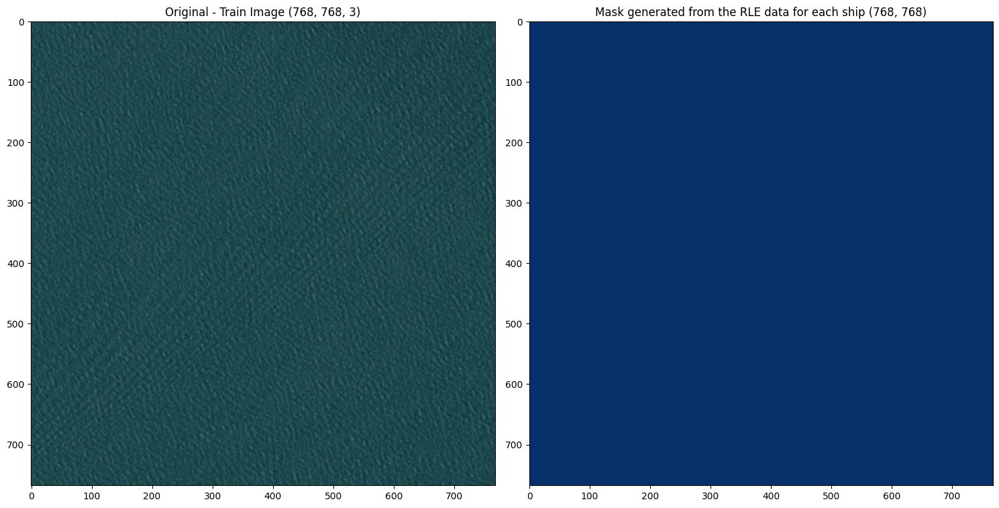

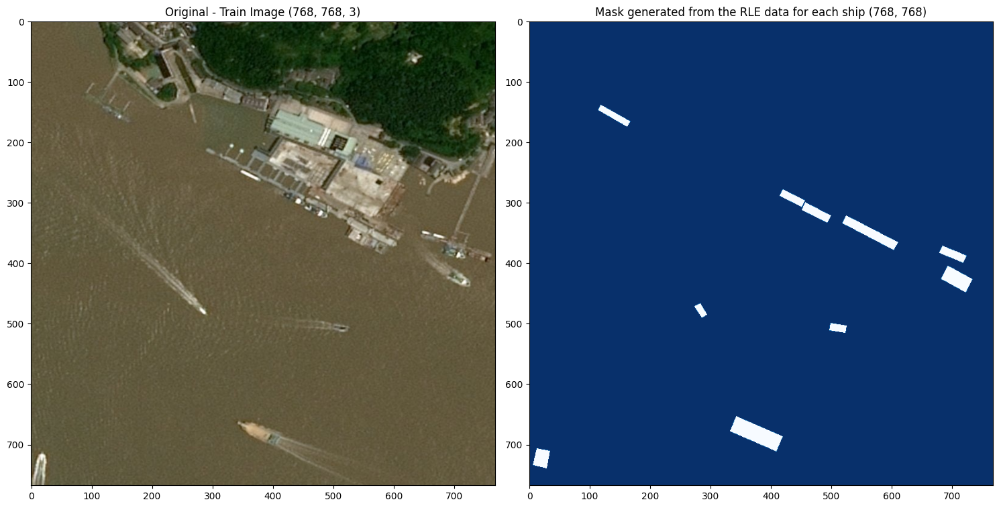

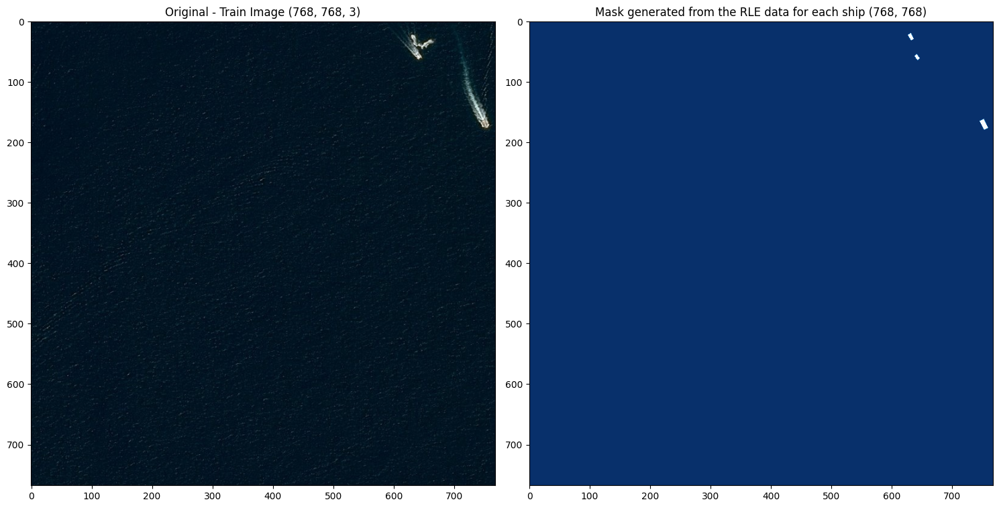

In [44]:
# afficher une image d'entainement et sa masque
from skimage.io import imread
for num in [100, 88, 5]:
    rle_0 = df.query(f'ImageId=="{train_images[num-1]}"')['EncodedPixels']
    img_0 = masks_image(rle_0)
    original = imread(train_image_dir+"/"+train_images[num-1])
    plt.figure(figsize=(15, 8))
    plt.subplot(1, 2, 1)
    plt.title(f"Original - Train Image {original.shape}")
    plt.imshow(original)
    plt.subplot(1, 2, 2)
    plt.title(f"Mask generated from the RLE data for each ship {img_0.shape}")
    plt.imshow(img_0, cmap = "Blues_r")
    plt.tight_layout()
    plt.show()

<Axes: >

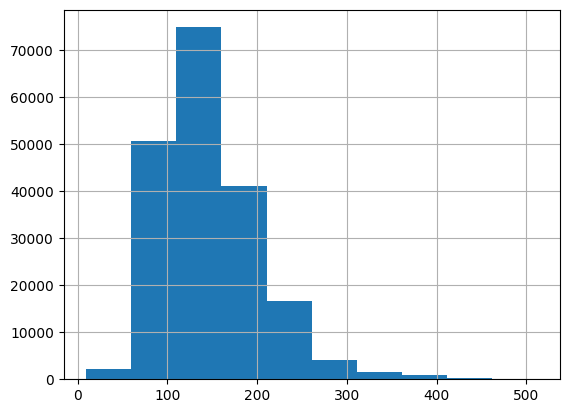

In [45]:
MonData['file_size_kb']=MonData['ImageId'].map(lambda c_img_id:os.stat(os.path.join(train_image_dir,c_img_id)).st_size/1024) # calcul de taille des fichiers
MonData['file_size_kb'].hist()

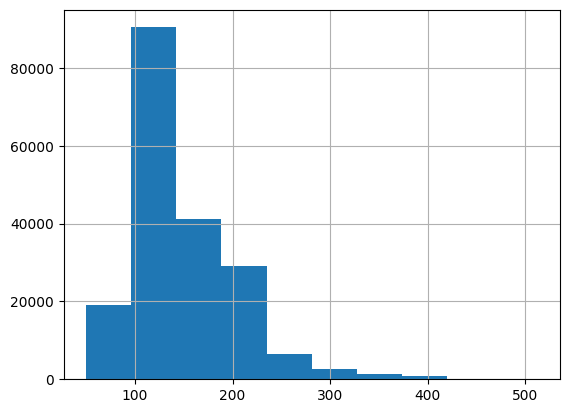

In [46]:
# Filtrer les données pour inclure uniquement les entrées dont la taille de fichier est supérieure à 50 ko
MonData = MonData[MonData.file_size_kb > 50] # Tracer un histogramme de la colonne 'file_size_kb' pour visualiser la distribution des tailles de fichier
MonData['file_size_kb'].hist()
MonData.sample(7) # Sélectionner aléatoirement 7 échantillons de l'ensemble de données
MonData.shape
df.drop(['Size'], axis=1, inplace=True) # Supprimer la colonne 'Size' du DataFrame df 


In [47]:
MonData.head()

,ImageId,ships,file_size_kb
0,00003e153.jpg,0,128.944336
1,0001124c7.jpg,0,76.059570
2,000155de5.jpg,1,147.625977
3,000194a2d.jpg,5,75.221680
4,0001b1832.jpg,0,95.627930


In [48]:
from sklearn.model_selection import train_test_split                   
# Diviser l'ensemble de données 'MonData' en ensembles d'entraînement (train) et de validation (valid)
train, valid = train_test_split(MonData, test_size=0.2, stratify=MonData['ships'])
print("le shape du dataframe de train est :",train.shape)


le shape du dataframe de train est : (153031, 3)


In [49]:
train_df = pd.merge(df, train) # Fusionner le DataFrame 'df' avec le DataFrame 'train' 
train_df.sort_values(by='ImageId') # Trier le DataFrame résultant 'train_df' par la colonne 'ImageId'
# Afficher le DataFrame 'train_df'
print(train_df)


              ImageId                                      EncodedPixels  \
0       0001124c7.jpg                                                NaN   
1       0001b1832.jpg                                                NaN   
2       00021ddc3.jpg  108287 1 109054 3 109821 4 110588 5 111356 5 1...   
3       00021ddc3.jpg  101361 1 102128 3 102896 4 103663 6 104430 9 1...   
4       00021ddc3.jpg  74441 3 75207 5 75975 5 76743 5 77511 5 78280 ...   
...               ...                                                ...   
184066  fffedbb6b.jpg                                                NaN   
184067  ffff2aa57.jpg                                                NaN   
184068  ffff6e525.jpg                                                NaN   
184069  ffffc50b4.jpg                                                NaN   
184070  ffffe97f3.jpg                                                NaN   

        file_size_kb  ships  
0          76.059570      0  
1          95.627930      0

**le nombre des lignes de train était 153031 après la division en train et validation mais après le fusionnage la taille de train df à 184071 lignes qui présentent des lignes de la même image mais de navire différent car les lignes de Df représentent des navires et une image peut continuer plusieurs navires**

In [50]:
valid_df = pd.merge(df, valid)
print("le shape du dataframe de validation est:",valid_df.shape)

le shape du dataframe de validation est: (46011, 4)


In [51]:
print("on trouve:")
print(train_df.shape[0], 'training masks,')
print(valid_df.shape[0], 'validation masks.')

on trouve:
184071 training masks,
46011 validation masks.


/tmp/ipykernel_13/8264421.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=train_df, x='ships', palette='Set2')


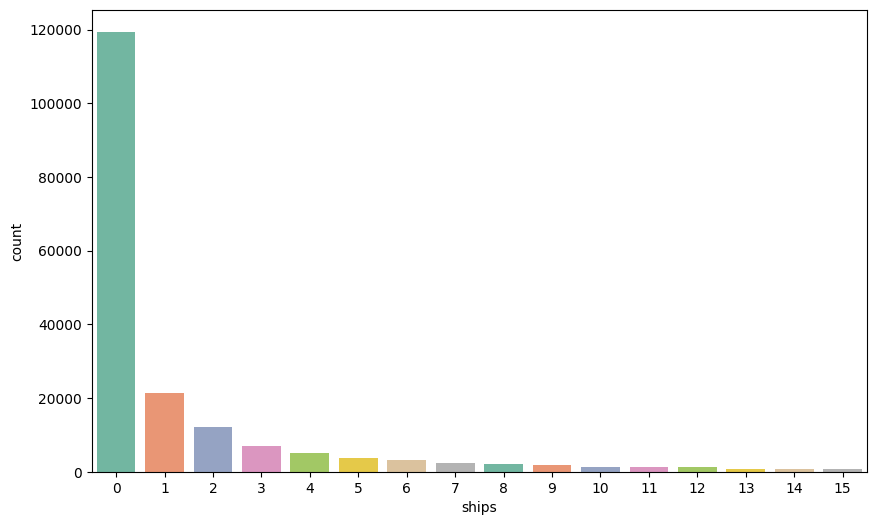

In [52]:
plt.figure(figsize=(10, 6))
sns.countplot(data=train_df, x='ships', palette='Set2')
plt.show()

In [53]:
# notre but dans ce code et d'essayer de fusionner le nombre des navires par image en deux classes pour balances les différentes images
train_df['grouped_ship_count'] = train_df.ships.map(lambda x: (x+1)//2).clip(0,7)
train_df.head()

,ImageId,EncodedPixels,file_size_kb,ships,grouped_ship_count
0,0001124c7.jpg,NaN,76.059570,0,0
1,0001b1832.jpg,NaN,95.627930,0,0
2,00021ddc3.jpg,108287 1 109054 3 109821 4 110588 5 111356 5 1...,242.910156,9,5
3,00021ddc3.jpg,101361 1 102128 3 102896 4 103663 6 104430 9 1...,242.910156,9,5
4,00021ddc3.jpg,74441 3 75207 5 75975 5 76743 5 77511 5 78280 ...,242.910156,9,5


In [54]:
# 0 est l'image ne represente aucun navire
# 1 les images qui presentent un navire et les images qui presentent 2 navires 
train_df.grouped_ship_count.value_counts() # Afficher le décompte des valeurs uniques dans la colonne 'grouped_ship_count' du DataFrame 'train_df'

grouped_ship_count
0    119434
1     33490
2     12122
3      6802
4      4276
5      3077
6      2441
7      2429
Name: count, dtype: int64

In [55]:
# Fonction pour échantillonner des entrées en fonction du nombre de navires 
def sample_ships(in_df, base_rep_val=2100):
    if in_df['ships'].values[0] == 0: # Vérifier si le nombre de navires est égal à 0
        return in_df.sample(base_rep_val // 3)   # échantillonner un tiers de la valeur 2100 
    else:
        return in_df.sample(base_rep_val)


In [56]:
balanced_train_df = train_df.groupby('grouped_ship_count').apply(sample_ships) # créer un dataframe plus ou moins balancé
balanced_train_df.grouped_ship_count.value_counts()
print("le shape du dataframe equiblibré est :",balanced_train_df.shape)

le shape du dataframe equiblibré est : (15400, 5)


In [57]:
#pour chaque sous groupe de 0a 7 on va afficher le nombre des image de train groupeés par le nombre des navires
for i in range(8):
    df_val_counts = balanced_train_df[balanced_train_df.grouped_ship_count==i].ships.value_counts()
    print(f"Data frame for grouped ship count = {i}:-\n{df_val_counts}\nSum of Values:- {df_val_counts.values.sum()}\n\n")

Data frame for grouped ship count = 0:-
ships
0    700
Name: count, dtype: int64
Sum of Values:- 700


Data frame for grouped ship count = 1:-
ships
1    1352
2     748
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 2:-
ships
3    1242
4     858
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 3:-
ships
5    1118
6     982
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 4:-
ships
7    1118
8     982
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 5:-
ships
9     1204
10     896
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 6:-
ships
11    1094
12    1006
Name: count, dtype: int64
Sum of Values:- 2100


Data frame for grouped ship count = 7:-
ships
14    735
15    690
13    675
Name: count, dtype: int64
Sum of Values:- 2100




/tmp/ipykernel_13/4073012505.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=train_df, x='ships', palette='Set2')
/tmp/ipykernel_13/4073012505.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=balanced_train_df, x='ships', palette='Set2')


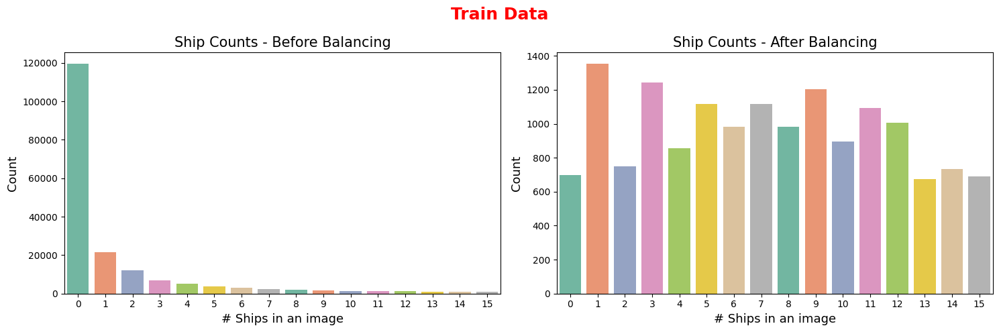

In [58]:
#Visualiser la distubution des données de training avant et après l'équilibrage
plt.figure(figsize=(15, 5))
plt.suptitle("Train Data", fontsize=18, color='r', weight='bold')

plt.subplot(1, 2, 1)
sns.countplot(data=train_df, x='ships', palette='Set2')
plt.title("Ship Counts - Before Balancing", fontsize=15)
plt.ylabel("Count", fontsize=13)
plt.xlabel("# Ships in an image", fontsize=13)

plt.subplot(1, 2, 2)
sns.countplot(data=balanced_train_df, x='ships', palette='Set2')
plt.title("Ship Counts - After Balancing", fontsize=15)
plt.xlabel("# Ships in an image", fontsize=13)
plt.ylabel("Count", fontsize=13)

plt.tight_layout()
plt.show()

In [59]:
BATCH_SIZE = 48 #taille du chaque batch
IMG_SCALING = (3, 3) #parametre de rédimensionement de l'image
def make_image_gen(in_df, batch_size=BATCH_SIZE):
    all_batches = list(in_df.groupby('ImageId'))
    out_rgb = []
    out_mask = []
    while True: 
        np.random.shuffle(all_batches) # Mélanger l'ordre des lots(batch)
        for c_img_id, c_masks in all_batches:
            # Chemin vers l'image RGB
            rgb_path = os.path.join(train_image_dir, c_img_id)
            c_img = imread(rgb_path) # Charger l'image
            c_mask = np.expand_dims(masks_image(c_masks['EncodedPixels'].values), -1) # Créer le masque à partir des encodages de pixels
            # Redimensionner l'image et le masque si spécifié
            if IMG_SCALING is not None:
                c_img = c_img[::IMG_SCALING[0], ::IMG_SCALING[1]]
                c_mask = c_mask[::IMG_SCALING[0], ::IMG_SCALING[1]]
            
            # Ajouter l'image et le masque aux listes
            out_rgb += [c_img]
            out_mask += [c_mask]            
            # Si la taille du lot (batch) est atteinte, renvoyer le lot
            if len(out_rgb) >= batch_size:
                yield np.stack(out_rgb, 0) / 255.0, np.stack(out_mask, 0)
                out_rgb, out_mask = [], []  # Réinitialiser les listes pour le prochain lot

In [60]:
train_gen = make_image_gen(balanced_train_df) #appel de la fonction 
# Image et Mask
train_x, train_y = next(train_gen)
print(f"train_x ~\nShape: {train_x.shape}\nvaleur min: {train_x.min()}\nvaleur max: {train_x.max()}")
print(f"\ntrain_y ~\nShape: {train_y.shape}\nvaleur min: {train_y.min()}\nvaleur max: {train_y.max()}")

train_x ~
Shape: (48, 256, 256, 3)
valeur min: 0.0
valeur max: 1.0

train_y ~
Shape: (48, 256, 256, 1)
valeur min: 0
valeur max: 1


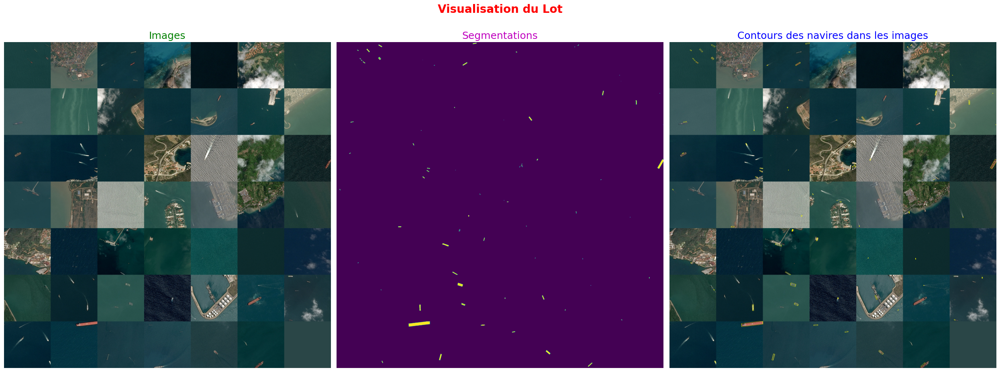

In [61]:
# Visualisation d'un lot d'entraînement
from skimage.segmentation import mark_boundaries
montage_rgb = lambda x: np.stack([montage(x[:, :, :, i]) for i in range(x.shape[3])], -1)
batch_rgb = montage_rgb(train_x) # Créer un montage d'images a partir de pile
batch_seg = montage(train_y[:, :,:,0])  # Créer un montage de masques
batch_overlap = mark_boundaries(batch_rgb, batch_seg.astype(int)) # Créer des contours autour des navires dans l'image
titles = ["Images", "Segmentations", "Contours des navires dans les images"] 
colors = ['g', 'm', 'b']  
display = [batch_rgb, batch_seg, batch_overlap]   
plt.figure(figsize=(25,10))                                                        
for i in range(3):                                                                
    plt.subplot(1, 3, i+1) # Créer le sous-graphique
    plt.imshow(display[i])                                                         
    plt.title(titles[i], fontsize=18, color=colors[i])                            
    plt.axis('off')                                                                
plt.suptitle("Visualisation du Lot", fontsize=20, color='r', weight='bold') 
plt.tight_layout()                                                                 


In [62]:
VALID_IMG_COUNT = 400 # Taille de lot validation
valid_x, valid_y = next(make_image_gen(valid_df, VALID_IMG_COUNT))
print(f"valid_x ~\nShape: {valid_x.shape}\nvaleur min: {valid_x.min()}\nvaleur max: {valid_x.max()}")
print(f"\nvalid_y ~\nShape: {valid_y.shape}\n valeur min: {valid_y.min()}\nvaleur max: {valid_y.max()}")

valid_x ~
Shape: (400, 256, 256, 3)
valeur min: 0.0
valeur max: 1.0

valid_y ~
Shape: (400, 256, 256, 1)
 valeur min: 0
valeur max: 1


In [63]:
# on va utiliser ImageDataGenerator pour l'augmentation du dnnées
from keras.preprocessing.image import ImageDataGenerator
# Paramètres pour la génération d'images augmentées
dg_args = dict(rotation_range=15,          # Plage de degrés pour les rotations aléatoires
               horizontal_flip=True,       # Effectue des retournements horizontaux aléatoires
               vertical_flip=True,         # Effectue des retournements verticaux aléatoires
               data_format='channels_last')  # channels_last se réfère à (lot, hauteur, largeur, canaux)


In [64]:
image_gen = ImageDataGenerator(**dg_args) # Créer un générateur d'images avec les paramètres spécifiés
label_gen = ImageDataGenerator(**dg_args) # Créer un générateur d'étiquettes avec les paramètres spécifiés
# Définir une fonction pour créer un générateur augmenté
def create_aug_gen(in_gen, seed=None):
    np.random.seed(seed if seed is not None else np.random.choice(range(9999)))
    
    for in_x, in_y in in_gen:
        seed = np.random.choice(range(9999))  # definir un seed pour avoir la meme augmentation pour l'image et le mask
        g_x = image_gen.flow(255 * in_x,
                             batch_size=in_x.shape[0],
                             seed=seed,
                             shuffle=False)
        
        g_y = label_gen.flow(in_y,
                             batch_size=in_x.shape[0],
                             seed=seed,
                             shuffle=False)

        yield next(g_x) / 255.0, next(g_y) # Normaliser les valeurs des pixels de l'image et de l'étiquette


In [65]:
# Augmenter les données d'entraînement
cur_gen = create_aug_gen(train_gen, seed=42)
t_x, t_y = next(cur_gen)

# Afficher les informations sur les données augmentées
print('x', t_x.shape, t_x.dtype, t_x.min(), t_x.max())
print('y', t_y.shape, t_y.dtype, t_y.min(), t_y.max())


x (48, 256, 256, 3) float32 0.0 1.0
y (48, 256, 256, 1) float32 0.0 1.0


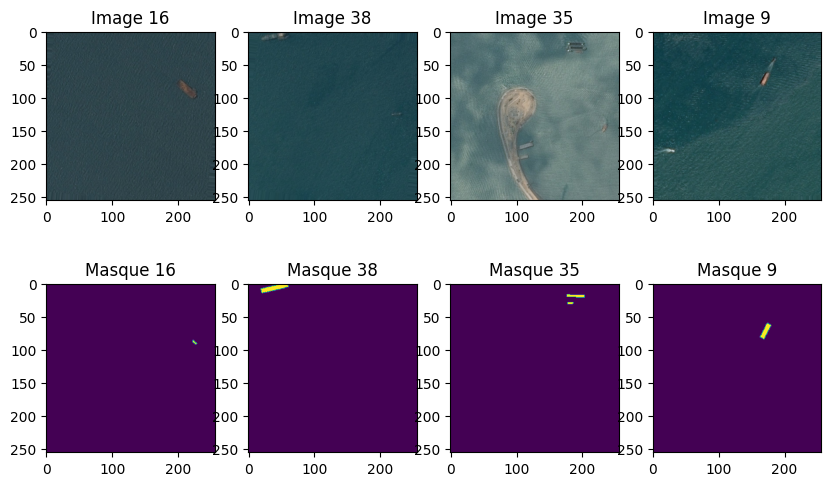

In [66]:
import random
# Nombre total d'exemples
total_examples = t_x.shape[0]
# Définir un seed pour rendre la sélection aléatoire reproductible
random_seed = 3
random.seed(random_seed)
random_indices = random.sample(range(total_examples), 4) # Sélectionner de manière aléatoire des indices pour les exemples à afficher
fig, axes = plt.subplots(2, 4, figsize=(10,6)) # Affichage de manière aléatoire des exemples d'images et de leurs masques
for i, random_index in enumerate(random_indices):
    # Afficher l'image
    axes[0, i].imshow(t_x[random_index])
    axes[0, i].set_title(f"Image {random_index + 1}")

    # Afficher le masque
    axes[1, i].imshow(t_y[random_index])
    axes[1, i].set_title(f"Masque {random_index + 1}")

plt.show()


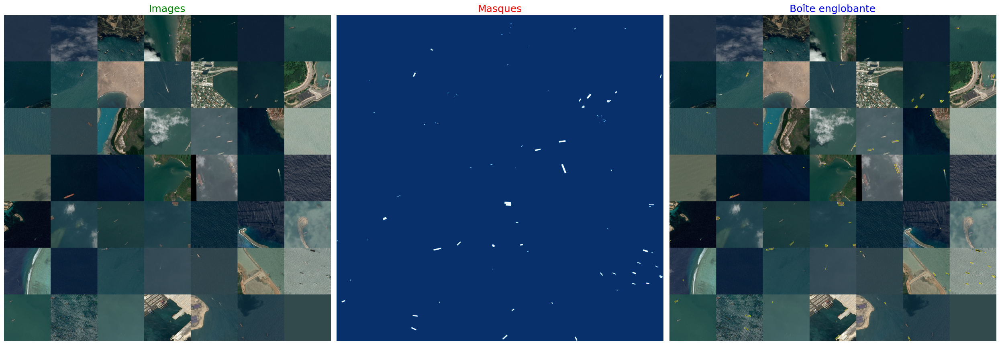

In [67]:
# Définir une fonction lambda pour créer un montage RGB à partir d'un tableau d'images
montage_rgb = lambda x: np.stack([montage(x[:, :, :, i]) for i in range(x.shape[3])], -1)
# Affichage final avant de passer les données au modèle
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(25, 10))

# Afficher le montage RGB des images d'entraînement
ax1.imshow(montage_rgb(t_x), cmap='gray')
ax1.set_title('Images', fontsize=18, color='g')
ax1.axis('off')

# Afficher le montage des masques
ax2.imshow(montage(t_y[:, :, :, 0]), cmap='Blues_r')
ax2.set_title('Masques', fontsize=18, color='r')
ax2.axis('off')

# Afficher les contours autour des navires dans les images d'entraînement
ax3.imshow(mark_boundaries(montage_rgb(t_x), montage(t_y[:, :, :, 0].astype(int))))
ax3.set_title('Boîte englobante', fontsize=18, color='b')
ax3.axis('off')
plt.tight_layout()


# **Construction du model**

In [70]:
from keras import models, layers
def unet(input_size=(256,256,3)):
    inputs=layers.Input(input_size)
    c1= layers.Conv2D(16,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(inputs)
    c1=layers.Dropout(0.1)(c1)
    c1= layers.Conv2D(16,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(inputs)
    p1=layers.MaxPooling2D((2,2))(c1)
    
    c2= layers.Conv2D(32,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(p1)
    c2=layers.Dropout(0.1)(c2)
    c2= layers.Conv2D(32,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c2)
    p2=layers.MaxPooling2D((2,2))(c2)
    
    c3= layers.Conv2D(64,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(p2)
    c3=layers.Dropout(0.1)(c3)
    c3= layers.Conv2D(64,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c3)
    p3=layers.MaxPooling2D((2,2))(c3)
    
    c4= layers.Conv2D(128,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(p3)
    c4=layers.Dropout(0.1)(c4)
    c4= layers.Conv2D(128,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c4)
    p4=layers.MaxPooling2D((2,2))(c4)
    
    c5= layers.Conv2D(256,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(p4)
    c5=layers.Dropout(0.1)(c5)
    c5= layers.Conv2D(256,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c5)
    
    u6=layers.Conv2DTranspose(128,(2,2),strides=(2,2),padding='same')(c5)
    u6=layers.concatenate([u6,c4])
    c6= layers.Conv2D(128,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(u6)
    c6=layers.Dropout(0.2)(c6)
    c6= layers.Conv2D(128,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c6)
    
    u7=layers.Conv2DTranspose(64,(2,2),strides=(2,2),padding='same')(c6)
    u7=layers.concatenate([u7,c3])
    c7= layers.Conv2D(64,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(u7)
    c7=layers.Dropout(0.2)(c7)
    c7= layers.Conv2D(64,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c7)
    
    u8=layers.Conv2DTranspose(32,(2,2),strides=(2,2),padding='same')(c7)
    u8=layers.concatenate([u8,c2])
    c8= layers.Conv2D(32,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(u8)
    c8=layers.Dropout(0.2)(c8)
    c8= layers.Conv2D(32,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c8)
    
    u9=layers.Conv2DTranspose(16,(2,2),strides=(2,2),padding='same')(c8)
    u9=layers.concatenate([u9,c1])
    c9= layers.Conv2D(16,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(u9)
    c9=layers.Dropout(0.2)(c9)
    c9= layers.Conv2D(16,(3,3),activation='relu',kernel_initializer='he_normal',padding='same')(c9)
    
    out = layers.Conv2D(1,(1,1),activation='sigmoid')(c9)
    
    model = models.Model(inputs=[inputs],outputs=[out])
    model.summary()
    return model

In [71]:
nouveau_model=unet()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d_11 (Conv2D)          (None, 256, 256, 16)         448       ['input_2[0][0]']             
                                                                                                  
 max_pooling2d_4 (MaxPoolin  (None, 128, 128, 16)         0         ['conv2d_11[0][0]']           
 g2D)                                                                                             
                                                                                                  
 conv2d_12 (Conv2D)          (None, 128, 128, 32)         4640      ['max_pooling2d_4[0][0]'] 

In [72]:
# les differentes layer du modele
nouveau_model.layers

In [73]:
import keras.backend as k
def dice_coeff(y_pred,y_true):
    y_true = k.cast(y_true, dtype=tf.float32)  
    y_pred = k.cast(y_pred, dtype=tf.float32)
    intersection= k.sum(y_pred * y_true,axis=[1,2,3])
    union= k.sum(y_pred,axis=[1,2,3]) + k.sum(y_true,axis=[1,2,3])
    dice_coefficient = k.mean((2. * intersection+1) / (union+1))
    return dice_coefficient 

In [74]:
def focal_loss(y_pred,y_true, gamma=2,alpha=0.8):
    y_true = k.cast(y_true, dtype=tf.float32)  
    y_pred = k.cast(y_pred, dtype=tf.float32)
    y_pred=k.flatten(y_pred)
    y_true=k.flatten(y_true)
    BCE = k.binary_crossentropy(y_pred,y_true)
    EXP_BCE= k.exp(-BCE)
    focal_loss= k.mean(alpha * k.pow((1-EXP_BCE),gamma)* BCE)
    return focal_loss

In [75]:
# tester la fonction qui calcule le dice_coeff
resultat_dice_coeff = dice_coeff(train_x, train_y)
print(resultat_dice_coeff.numpy())


0.009213963


In [76]:
from tensorflow.keras.optimizers import Adam
nouveau_model.compile(optimizer=Adam(1e-3,beta_1=1e-6),loss=focal_loss,metrics=[dice_coeff])

In [77]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
reduce = ReduceLROnPlateau(monitor='val_dice_coeff', factor=0.23,
                                   patience=3, verbose=1, mode='max',
                                   min_delta=0.0001, cooldown=2, min_lr=1e-6)

early = EarlyStopping(monitor="val_dice_coeff", mode="max",
                      patience=20)

callbacks_list = [reduce,early]

In [78]:
aug_gen = create_aug_gen(train_gen)


In [79]:
nouveau_model.fit(aug_gen,epochs=200,validation_data=(valid_x, valid_y),steps_per_epoch=30,
                 callbacks=callbacks_list)

Epoch 1/200
30/30 [==============================] - 130s 4s/step - loss: 0.0311 - dice_coeff: 0.0057 - val_loss: 0.0050 - val_dice_coeff: 0.0041 - lr: 0.0010
Epoch 2/200
30/30 [==============================] - 124s 4s/step - loss: 0.0067 - dice_coeff: 0.0126 - val_loss: 0.0025 - val_dice_coeff: 0.0084 - lr: 0.0010
Epoch 3/200
30/30 [==============================] - 123s 4s/step - loss: 0.0058 - dice_coeff: 0.0173 - val_loss: 0.0022 - val_dice_coeff: 0.0100 - lr: 0.0010
Epoch 4/200
30/30 [==============================] - 124s 4s/step - loss: 0.0043 - dice_coeff: 0.0287 - val_loss: 0.0016 - val_dice_coeff: 0.0197 - lr: 0.0010
Epoch 5/200
30/30 [==============================] - 124s 4s/step - loss: 0.0047 - dice_coeff: 0.0304 - val_loss: 0.0017 - val_dice_coeff: 0.0188 - lr: 0.0010
Epoch 6/200
30/30 [==============================] - 124s 4s/step - loss: 0.0038 - dice_coeff: 0.0372 - val_loss: 0.0015 - val_dice_coeff: 0.0192 - lr: 0.0010
Epoch 7/200
30/30 [===========================

In [84]:
nouveau_model.save('nouveau_model.h5')

In [85]:
from tensorflow.keras.models import load_model
final_model=load_model('nouveau_model.h5',custom_objects={'focal_loss':focal_loss,'dice_coeff':dice_coeff})

In [103]:
def prediction(path, img_id, model):
    img = imread(os.path.join(path, img_id))
    img = img[::3, ::3] 
    img=img/255.0# Redimensionner l'image à la taille attendue par le modèle
    img = np.expand_dims(img, axis=0)

    # Assurez-vous de fournir les données à la méthode predict
    pred = model.predict(img)

    img = np.squeeze(img, axis=0)
    predo = np.squeeze(pred, axis=0)
    return img, pred

(768, 768, 3)
1/1 [==============================] - 0s 51ms/step


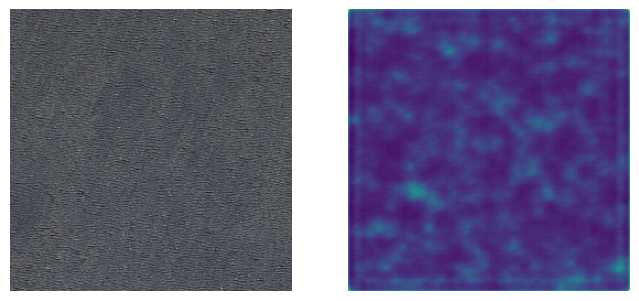

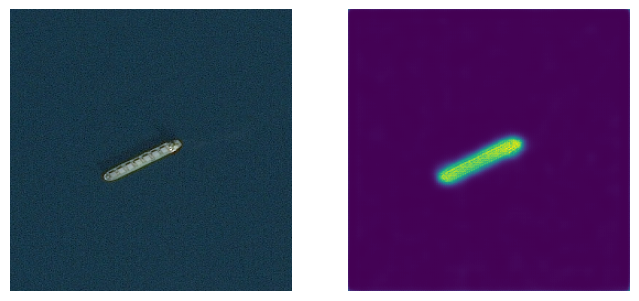

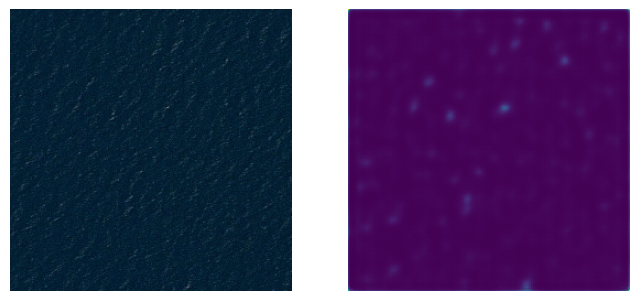

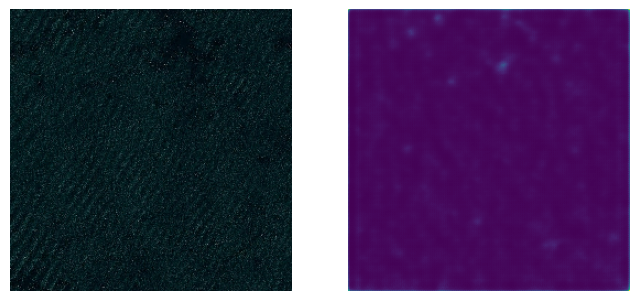

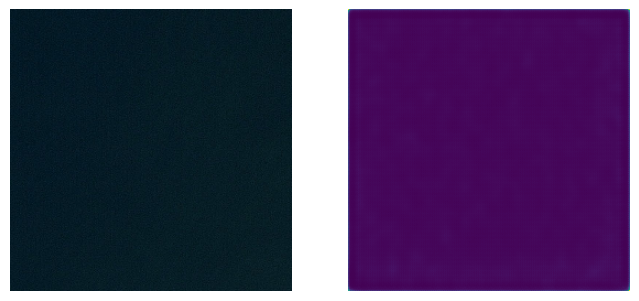

...

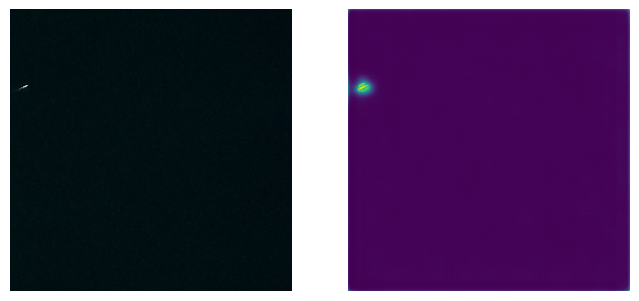

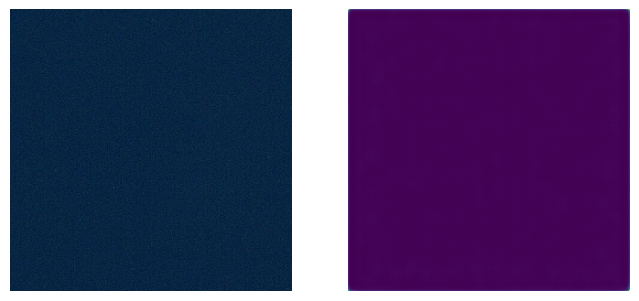

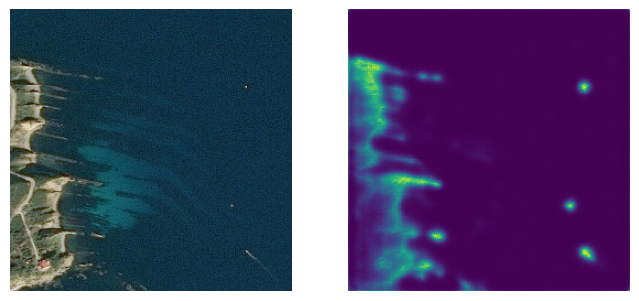

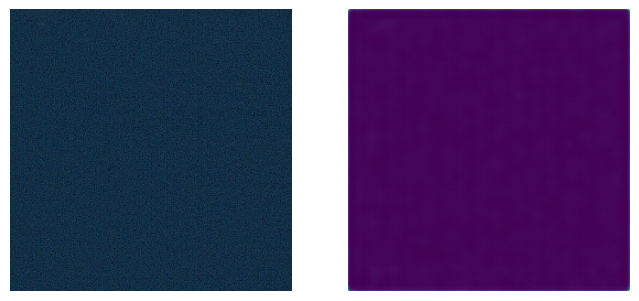

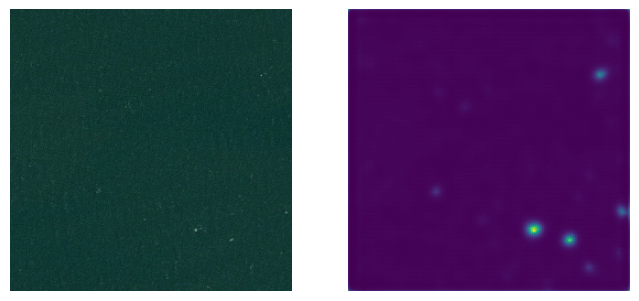

In [104]:
# evaluation du modele
print(cv2.imread("/kaggle/input/airbus-ship-detection/test_v2/00002bd58.jpg").shape)
for sampl in range(20):
    img,pred = prediction("/kaggle/input/airbus-ship-detection/test_v2",test_images[sampl],final_model)
    fig=plt.figure(figsize=(8,8))
    fig.add_subplot(1,2,1)
    plt.imshow(img)
    plt.axis('off')
    
    pred_squeezed = np.squeeze(pred, axis=0)
    fig.add_subplot(1,2,2)
    plt.imshow(pred_squeezed)
    plt.axis('off')